# EXPLORING EACH DATASET

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.metrics import ConfusionMatrixDisplay, accuracy_score, confusion_matrix, f1_score, recall_score, precision_score
import seaborn as sn
from imblearn.over_sampling import SMOTE
from numpy import absolute
from pandas import read_csv
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from xgboost import XGBRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error


In [2]:
def reg_acc(md, data, test_labels):
  test_predictions = md.predict(data).flatten()
  r2 = r2_score(test_labels, test_predictions)
  rmse = np.sqrt(mean_squared_error(test_labels, test_predictions))
  mae = mean_absolute_error(test_labels, test_predictions)

  print(f'r2 score: {r2}')
  print(f'rmse score: {rmse}')
  print(f'mae score: {mae}')
  # print(f'erro medio de: {rmse} segundos')

  plt.scatter(test_labels, test_predictions)
  plt.xlabel('True Values')
  plt.ylabel('Predictions')
  plt.axis('equal')
  plt.axis('square')
  plt.xlim([0,plt.xlim()[1]])
  plt.ylim([0,plt.ylim()[1]])
  _ = plt.plot([-100, 100], [-100, 100])

# COMPUTING 

## Pinned

Nesse experimento cada core tem um vBS a qual é responsável. Os datasets tem conformações diferentes em relação a quais núcleos foram designados dentre os 8 da máquina. 

O conjunto {1,2,3,4} significa caches L1 e L2 isoladas
enquanto o conjunto {1,5,2,6} significa {1,2} e {5,6} compartilham as caches l1 e l2, enquanto não compartilham cache entre si.

In [3]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns

%cd "/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/computing_datasets/datasets_pin"
df_list = [pd.read_csv(name) for name in os.listdir()]

/home/usr/anaconda3/envs/fault_pred/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/computing_datasets/datasets_pin


### Exploratory Analysis

In [4]:
def correlation(df):

  font = {'family' : 'serif', 'weight' : 'bold', 'size':10}
  plt.rc('font', **font)

  corr_matrix = df.corr()
  sns.heatmap(corr_matrix, annot=True)
  plt.show()

In [5]:
print(df_list[0].columns)
print("")
i = 0
for df in df_list:
    print(f"tamanho do dataset {i}: {len(df)}")
    i += 1

Index(['mcs_dl_1', 'mcs_ul_1', 'dl_kbps_1', 'ul_kbps_1', 'cpu_set_1',
       'mcs_dl_2', 'mcs_ul_2', 'dl_kbps_2', 'ul_kbps_2', 'cpu_set_2',
       'mcs_dl_3', 'mcs_ul_3', 'dl_kbps_3', 'ul_kbps_3', 'cpu_set_3',
       'mcs_dl_4', 'mcs_ul_4', 'dl_kbps_4', 'ul_kbps_4', 'cpu_set_4', 'cpu_0',
       'cpu_1', 'cpu_2', 'cpu_3', 'cpu_4', 'cpu_5', 'cpu_6', 'cpu_7',
       'explode'],
      dtype='object')

tamanho do dataset 0: 40000
tamanho do dataset 1: 20000
tamanho do dataset 2: 20000
tamanho do dataset 3: 40000


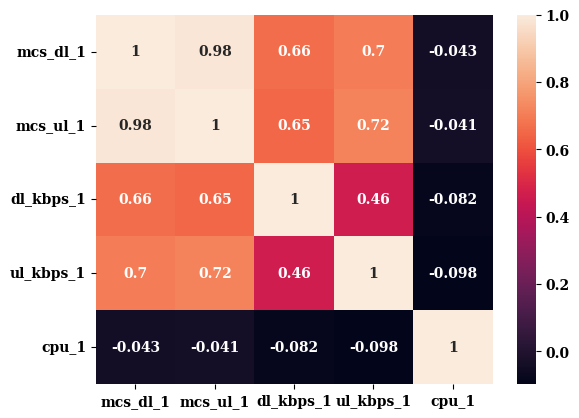

In [6]:
correlation(df_list[3][['mcs_dl_1', 'mcs_ul_1', 'dl_kbps_1', 'ul_kbps_1','cpu_1']])

In [7]:
import plotly.express as px

def ul_dl_mcs_visual(df):
    df = df.sample(frac=0.2)
    fig = make_subplots(rows=1, cols=2, subplot_titles=['downlink','uplink'])

    fig.add_trace(go.Scatter(x=df['dl_kbps_1'], y=df['mcs_dl_1'] ,mode="markers"), row=1, col=1)
    fig.add_trace(go.Scatter(x=df['ul_kbps_1'], y= df['mcs_ul_1'],mode="markers"), row=1, col=2)

    fig.update_layout(showlegend=False, title_text="mcs x bit rate")
    fig.show()

In [8]:
ul_dl_mcs_visual(df_list[1])

In [9]:
def explodePlot(ds_list):

    fig = make_subplots(rows=2, cols=2, start_cell="top-left", subplot_titles=[f"Dataset {k}" for k in range(0,len(ds_list))])

    
    for i in range(2):
        for j in range(2):
            qtt_df = ds_list[i+j]['explode'].value_counts().to_frame().T

            fig.add_trace(go.Bar(x=[str(s) for s in qtt_df.to_dict().keys()], y= qtt_df.values[0]),
                row=i+1, col=j+1)

    fig.update_layout(showlegend=False, title_text="explode frequency per dataset")
    fig.show()

In [10]:
explodePlot(df_list)

In [11]:
df_list[3].describe()

,mcs_dl_1,mcs_ul_1,dl_kbps_1,ul_kbps_1,cpu_set_1,mcs_dl_2,mcs_ul_2,dl_kbps_2,ul_kbps_2,cpu_set_2,...,ul_kbps_4,cpu_set_4,cpu_0,cpu_1,cpu_2,cpu_3,cpu_4,cpu_5,cpu_6,cpu_7
count,40000.000000,40000.000000,40000.000000,40000.000000,40000.0,40000.000000,40000.000000,40000.000000,40000.000000,40000.0,...,40000.000000,40000.0,40000.0,40000.000000,40000.00000,40000.0,40000.0,40000.000000,40000.00000,40000.0
mean,13.613625,9.365800,6796.327000,4536.605400,1.0,13.761800,9.511825,6842.344400,4564.228000,2.0,...,4547.365000,6.0,0.0,0.590309,0.58992,0.0,0.0,0.589351,0.58984,0.0
std,6.957995,7.167111,6062.921444,4613.114951,0.0,6.963492,7.178583,6060.014958,4619.278397,0.0,...,4627.245657,0.0,0.0,0.319962,0.32003,0.0,0.0,0.319501,0.31986,0.0
min,0.000000,0.000000,32.000000,16.000000,1.0,0.000000,0.000000,32.000000,16.000000,2.0,...,16.000000,6.0,0.0,0.000000,0.00000,0.0,0.0,0.000000,0.00000,0.0
25%,8.000000,2.000000,2088.000000,1000.000000,1.0,8.000000,2.000000,2152.000000,1000.000000,2.0,...,1000.000000,6.0,0.0,0.570000,0.57000,0.0,0.0,0.570000,0.57000,0.0
50%,15.000000,9.000000,4968.000000,2728.000000,1.0,15.000000,9.000000,4968.000000,2792.000000,2.0,...,2728.000000,6.0,0.0,0.710000,0.71000,0.0,0.0,0.710000,0.71000,0.0
75%,19.000000,17.000000,9912.000000,6712.000000,1.0,19.000000,17.000000,9912.000000,6712.000000,2.0,...,6712.000000,6.0,0.0,0.790000,0.79000,0.0,0.0,0.790000,0.79000,0.0
max,26.000000,20.000000,30576.000000,19848.000000,1.0,26.000000,20.000000,30576.000000,19848.000000,2.0,...,19848.000000,6.0,0.0,1.000000,1.00000,0.0,0.0,1.000000,1.00000,0.0


In [40]:
df_list[3][df_list[3]['explode'] == True]

,mcs_dl_1,mcs_ul_1,dl_kbps_1,ul_kbps_1,cpu_set_1,mcs_dl_2,mcs_ul_2,dl_kbps_2,ul_kbps_2,cpu_set_2,...,cpu_set_4,cpu_0,cpu_1,cpu_2,cpu_3,cpu_4,cpu_5,cpu_6,cpu_7,explode
3,8,4,6456,2472,1,8,4,4392,1192,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
5,22,19,10680,16992,1,18,15,1288,9912,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
17,25,20,4008,18336,1,18,15,12216,4584,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
24,2,0,1064,376,1,18,15,5544,3496,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
25,10,4,6200,2600,1,18,15,15840,12216,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39966,15,12,4584,7224,1,15,11,13536,872,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
39969,15,10,7224,3112,1,24,20,22920,14688,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
39974,18,15,14112,12960,1,15,11,3752,1384,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True
39984,13,8,10680,4264,1,2,0,296,1128,2,...,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,True


In [12]:
def timeSeries(df, param, bool=True):
    if(bool): colormap = {False: 'green', True : 'red'}
    else: colormap = {0: 'green', 1 : 'red'}

    fig_dl = px.scatter(df.iloc[:4000], y=param, color='explode', color_discrete_map=colormap, title= f'grafico de dl_kbps_1')

    line_fig_dl = px.line(df.iloc[:4000], y=param)
    line_fig_dl.update_traces(line=dict(color = 'rgba(50,50,50,0.2)'))

    fig = go.Figure(data=(fig_dl.data + line_fig_dl.data))
    fig.show()

timeSeries(df_list[3], 'cpu_6')

### predicting cpu usage

In [13]:
df_list[3][['cpu_set_1','cpu_set_2','cpu_set_3','cpu_set_4']].head(1)

,cpu_set_1,cpu_set_2,cpu_set_3,cpu_set_4
0,1,2,5,6


In [14]:
def arrFunc(input):
    arr = []

    for i in input:
        if(i[1] > 0):
            arr.append(i)

    return arr

Excluindo os registros em que há falha é possível estimar com precisão o uso do Core da CPU a partir das métricas coletadas.

r2 score: 0.9805413885751302
rmse score: 0.014609827118068006
mae score: 0.011612464246214768


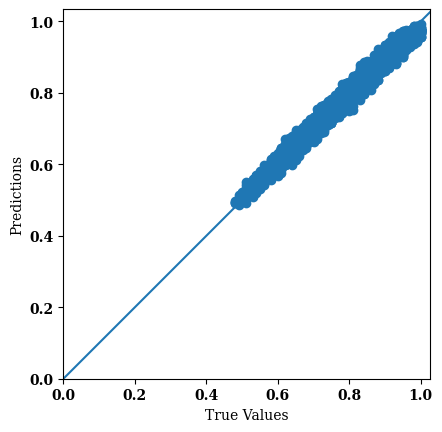

In [68]:
y_pin = df_list[3]['cpu_1'].values
X_pin = df_list[3][['mcs_dl_1', 'mcs_ul_1', 'dl_kbps_1', 'ul_kbps_1']].values

subset = arrFunc(zip(X_pin, y_pin))
y_pin = [i[1] for i in subset]
X_pin = [i[0] for i in subset]

X_train_pin, X_test_pin, y_train_pin, y_test_pin = train_test_split(X_pin,y_pin, test_size=0.2, random_state=42)
XGBmodel1 = XGBRegressor(n_estimators=100, max_depth=5, eta=0.05)
XGBmodel1 = XGBmodel1.fit(X_train_pin, y_train_pin)
reg_acc(XGBmodel1, X_test_pin, y_test_pin)

#### other cores

r2 score: 0.20658900190290008
rmse score: 0.27993968597224317
mae score: 0.2051058503596956


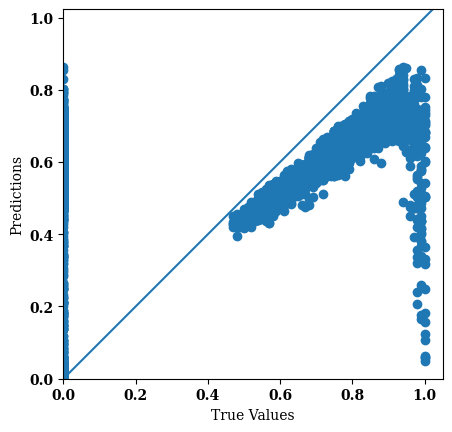

In [16]:
y_pin = df_list[3]['cpu_2'].values
X_pin = df_list[3][['mcs_dl_2', 'mcs_ul_2', 'dl_kbps_2', 'ul_kbps_2']].values
X_train_pin, X_test_pin, y_train_pin, y_test_pin = train_test_split(X_pin,y_pin, test_size=0.2, random_state=42)
XGBmodel1 = XGBRegressor(n_estimators=100, max_depth=5, eta=0.05)
XGBmodel1 = XGBmodel1.fit(X_train_pin, y_train_pin)
reg_acc(XGBmodel1, X_test_pin, y_test_pin)

r2 score: 0.22615012639680887
rmse score: 0.2768201422131696
mae score: 0.20275889883032244


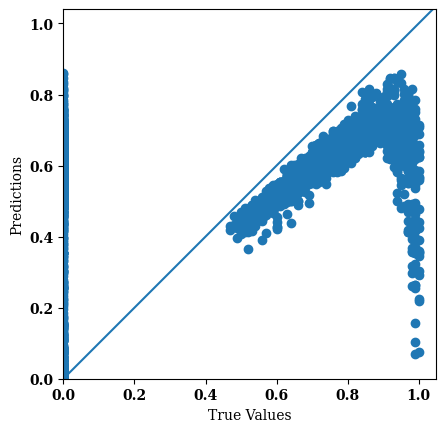

In [17]:
y_pin = df_list[3]['cpu_5'].values
X_pin = df_list[3][['mcs_dl_3', 'mcs_ul_3', 'dl_kbps_3', 'ul_kbps_3']].values
X_train_pin, X_test_pin, y_train_pin, y_test_pin = train_test_split(X_pin,y_pin, test_size=0.2, random_state=42)
XGBmodel1 = XGBRegressor(n_estimators=100, max_depth=5, eta=0.05)
XGBmodel1 = XGBmodel1.fit(X_train_pin, y_train_pin)
reg_acc(XGBmodel1, X_test_pin, y_test_pin)

r2 score: 0.22461465231314937
rmse score: 0.27689855258057117
mae score: 0.2026722195815068


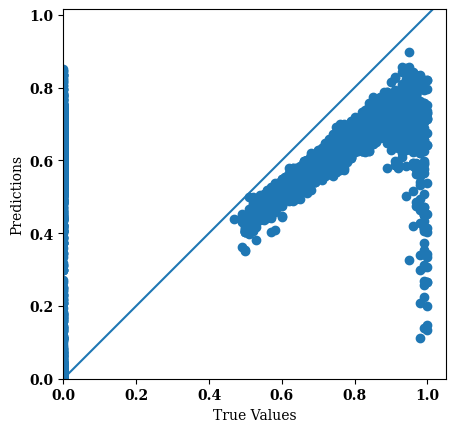

In [18]:
y_pin = df_list[3]['cpu_6'].values
X_pin = df_list[3][['mcs_dl_4', 'mcs_ul_4', 'dl_kbps_4', 'ul_kbps_4']].values
X_train_pin, X_test_pin, y_train_pin, y_test_pin = train_test_split(X_pin,y_pin, test_size=0.2, random_state=42)
XGBmodel1 = XGBRegressor(n_estimators=100, max_depth=5, eta=0.05)
XGBmodel1 = XGBmodel1.fit(X_train_pin, y_train_pin)
reg_acc(XGBmodel1, X_test_pin, y_test_pin)

## Classifying Fault Configs

In [50]:
def show_results(y_test, predictions):
  print('Accuracy score:', accuracy_score(y_test, predictions))
  print(f'f1-score: {f1_score(y_test, predictions)}')

  disp = ConfusionMatrixDisplay(confusion_matrix(y_test, predictions), display_labels=None)
  disp.plot()

In [41]:
clf_df = df_list[3].copy()

In [43]:
clf_df.columns

Index(['mcs_dl_1', 'mcs_ul_1', 'dl_kbps_1', 'ul_kbps_1', 'cpu_set_1',
       'mcs_dl_2', 'mcs_ul_2', 'dl_kbps_2', 'ul_kbps_2', 'cpu_set_2',
       'mcs_dl_3', 'mcs_ul_3', 'dl_kbps_3', 'ul_kbps_3', 'cpu_set_3',
       'mcs_dl_4', 'mcs_ul_4', 'dl_kbps_4', 'ul_kbps_4', 'cpu_set_4', 'cpu_0',
       'cpu_1', 'cpu_2', 'cpu_3', 'cpu_4', 'cpu_5', 'cpu_6', 'cpu_7',
       'explode'],
      dtype='object')

In [44]:
clf_df = clf_df.drop(columns=['cpu_set_1','cpu_set_2','cpu_set_3','cpu_set_4','cpu_0',
       'cpu_1', 'cpu_2', 'cpu_3', 'cpu_4', 'cpu_5', 'cpu_6', 'cpu_7',])

In [47]:
clf_df['explode'] = clf_df['explode'].apply(lambda x: 1 if x==True else 0)

In [54]:
X_clf = clf_df.drop(columns=['explode']).values
y_clf = clf_df['explode'].values

X_train_clf, X_test_clf, y_train_clf, y_test_clf = train_test_split(X_clf, y_clf, test_size=0.2, random_state=42)

sm = SMOTE(sampling_strategy='auto',random_state=15)
X_train_clf, y_train_clf = sm.fit_resample(X_train_clf, y_train_clf)


Accuracy score: 0.96025
f1-score: 0.905693950177936


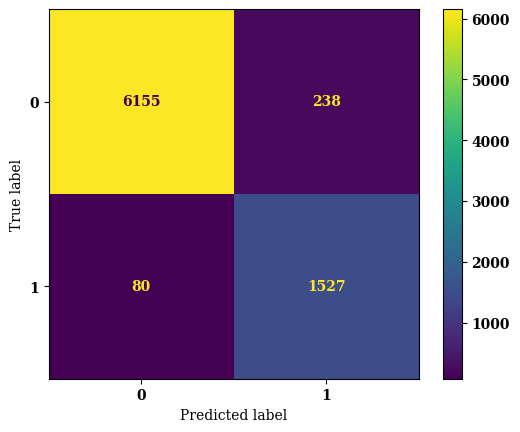

In [67]:
xgb_clf = xgb.XGBClassifier(eta = 0.1, n_estimators=50)
xgb_clf.fit(X_train_clf, y_train_clf)
predictions  = xgb_clf.predict(X_test_clf)
show_results(y_test_clf, predictions)

In [ ]:
fuller_df = clf_df.copy()

for i in range(1,5):
    preds = XGBmodel1.predict(fuller_df[[f'mcs_dl_{i}', f'mcs_ul_{i}', f'dl_kbps_{i}', f'ul_kbps_{i}']].values)
    fuller_df[f'cpu_{i}'] = preds

In [73]:
fuller_df

,mcs_dl_1,mcs_ul_1,dl_kbps_1,ul_kbps_1,mcs_dl_2,mcs_ul_2,dl_kbps_2,ul_kbps_2,mcs_dl_3,mcs_ul_3,...,ul_kbps_3,mcs_dl_4,mcs_ul_4,dl_kbps_4,ul_kbps_4,explode,cpu_1,cpu_2,cpu_3,cpu_4
0,2,0,1320,648,13,7,904,1480,7,2,...,32,20,18,13536,7224,0,0.722360,0.587428,0.600109,0.855248
1,6,1,2792,600,15,11,9912,1224,6,1,...,1736,25,20,19848,8248,0,0.683129,0.689508,0.811388,0.875930
2,20,17,13536,1800,24,20,18336,10296,15,9,...,936,10,4,2024,1192,0,0.720451,0.917948,0.707081,0.662163
3,8,4,6456,2472,8,4,4392,1192,6,1,...,1608,26,20,25456,13536,1,0.779999,0.700465,0.783190,0.991295
4,13,8,9528,5992,2,0,1800,1160,26,20,...,6200,19,17,16416,7224,0,0.868194,0.786526,0.819354,0.874197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39995,15,11,10296,4968,22,19,15264,5160,15,9,...,616,26,20,22152,5160,0,0.815036,0.803470,0.668133,0.829106
39996,10,4,3496,2600,24,20,11832,10296,8,2,...,2024,10,4,5992,1480,0,0.755665,0.883956,0.813052,0.728825
39997,19,17,3624,12960,15,12,12576,4392,22,19,...,17568,13,7,2472,4584,0,0.922162,0.802407,0.956938,0.747391
39998,13,8,904,4968,20,18,5544,15264,8,4,...,256,15,12,9144,776,0,0.729767,0.962532,0.604583,0.678856


In [85]:
def plotUsage(df):

    fig = make_subplots(rows=1, cols=2, start_cell="top-left", subplot_titles=("explode cases", "normal cases"), shared_yaxes=True)
    cpu_list = ['cpu_1', 'cpu_2', 'cpu_3', 'cpu_4']


    fig.add_trace(go.Bar(x=cpu_list, y= df[df['explode'] == 1][cpu_list].describe().T['mean']),
        row=1, col=1)
    
    fig.add_trace(go.Bar(x=cpu_list, y= df[df['explode'] == 0][cpu_list].describe().T['mean']),
        row=1, col=2)
            
    fig.update_layout(showlegend=False, title_text="CPU usage")
    fig.show()

In [86]:
plotUsage(fuller_df)

In [87]:
fuller_df['cpu_sum'] = fuller_df[['cpu_1','cpu_2','cpu_3','cpu_4']].apply(lambda x: np.sum([x.cpu_1, x.cpu_2, x.cpu_3, x.cpu_4]), axis=1)
fuller_df['cpu_max'] = fuller_df[['cpu_1','cpu_2','cpu_3','cpu_4']].apply(lambda x: np.max([x.cpu_1, x.cpu_2, x.cpu_3, x.cpu_4]), axis=1)

In [89]:
fig = px.scatter(fuller_df, x="cpu_sum", y="cpu_max", color="explode")
fig.show()

# Legado

### Time Series Analysis

In [35]:
def autocorr(df, col, n = 20):
    print("Autocorrelation with:")
    for i in range(1, n):
        a = df[col].autocorr(lag=i)
        print(f"lag {i}: {a:.3g}", end='; ')
        if(i % 5 == 0): print("")

In [76]:
ts_df = fuller_df.copy()
ts_df['overall_cpu_4'] = ts_df[['cpu_1','cpu_2','cpu_3','cpu_4']].apply(lambda x: np.mean([x.cpu_1, x.cpu_2, x.cpu_3, x.cpu_4]), axis=1)

In [77]:
ts_df

,mcs_dl_1,mcs_ul_1,dl_kbps_1,ul_kbps_1,mcs_dl_2,mcs_ul_2,dl_kbps_2,ul_kbps_2,mcs_dl_3,mcs_ul_3,...,mcs_dl_4,mcs_ul_4,dl_kbps_4,ul_kbps_4,explode,cpu_1,cpu_2,cpu_3,cpu_4,overall_cpu_4
0,2,0,1320,648,13,7,904,1480,7,2,...,20,18,13536,7224,0,0.722360,0.587428,0.600109,0.855248,0.691286
1,6,1,2792,600,15,11,9912,1224,6,1,...,25,20,19848,8248,0,0.683129,0.689508,0.811388,0.875930,0.764989
2,20,17,13536,1800,24,20,18336,10296,15,9,...,10,4,2024,1192,0,0.720451,0.917948,0.707081,0.662163,0.751911
3,8,4,6456,2472,8,4,4392,1192,6,1,...,26,20,25456,13536,1,0.779999,0.700465,0.783190,0.991295,0.813737
4,13,8,9528,5992,2,0,1800,1160,26,20,...,19,17,16416,7224,0,0.868194,0.786526,0.819354,0.874197,0.837068
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39995,15,11,10296,4968,22,19,15264,5160,15,9,...,26,20,22152,5160,0,0.815036,0.803470,0.668133,0.829106,0.778936
39996,10,4,3496,2600,24,20,11832,10296,8,2,...,10,4,5992,1480,0,0.755665,0.883956,0.813052,0.728825,0.795375
39997,19,17,3624,12960,15,12,12576,4392,22,19,...,13,7,2472,4584,0,0.922162,0.802407,0.956938,0.747391,0.857224
39998,13,8,904,4968,20,18,5544,15264,8,4,...,15,12,9144,776,0,0.729767,0.962532,0.604583,0.678856,0.743935


In [22]:
ts_df_corr = ts_df.replace({True: 1 , False: 0})


/tmp/ipykernel_7188/169681799.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [23]:
timeSeries(ts_df, 'overall_cpu_4')

In [24]:
autocorr(ts_df_corr, 'overall_cpu_4')

Autocorrelation with:
lag 1: -0.00342; lag 2: -0.00138; lag 3: 0.00382; lag 4: 0.00917; lag 5: 0.00019; 
lag 6: 0.00351; lag 7: -0.00309; lag 8: 0.00185; lag 9: 0.00247; lag 10: 0.00329; 
lag 11: 0.000522; lag 12: -0.00923; lag 13: -0.00522; lag 14: 0.000417; lag 15: -0.00337; 
lag 16: -0.00387; lag 17: 0.0075; lag 18: 0.0038; lag 19: 0.00512; 

In [25]:
ts_df['rol_mean'] = ts_df.overall_cpu_4.rolling(5).mean()

In [26]:
timeSeries(ts_df, 'rol_mean')

In [27]:
autocorr(ts_df, 'rol_mean')

Autocorrelation with:
lag 1: 0.8; lag 2: 0.604; lag 3: 0.408; lag 4: 0.211; lag 5: 0.0107; 
lag 6: 0.0107; lag 7: 0.0086; lag 8: 0.00563; lag 9: 0.00165; lag 10: -0.00136; 
lag 11: -0.00633; lag 12: -0.0116; lag 13: -0.0122; lag 14: -0.00969; lag 15: -0.00581; 
lag 16: -0.000415; lag 17: 0.0074; lag 18: 0.0121; lag 19: 0.0129; 

In [28]:
ts_df['rol_std'] = ts_df.overall_cpu_4.rolling(5).std()

In [29]:
timeSeries(ts_df, 'rol_std')

aparentemente uma variação muito grande na média parece estar correlacionado com um registro de falha. Além disso, aparentemente um desvio padrão abaixo de 0.3 pode ser um indicativo que NÃO haverá falha.

In [30]:
ts_df_corr['rol_std'] = ts_df['rol_std'].values
autocorr(ts_df_corr,'rol_std')

Autocorrelation with:
lag 1: 0.745; lag 2: 0.52; lag 3: 0.321; lag 4: 0.15; lag 5: 0.00347; 
lag 6: -0.001; lag 7: -0.00297; lag 8: -0.00239; lag 9: -0.00354; lag 10: -0.00499; 
lag 11: -0.00734; lag 12: -0.00987; lag 13: -0.0104; lag 14: -0.00855; lag 15: -0.0043; 
lag 16: 0.00213; lag 17: 0.00942; lag 18: 0.017; lag 19: 0.0204; 

In [31]:
ts_df['std_diff'] = ts_df['rol_std'].rolling(window=2).apply(np.diff)

In [32]:
ts = timeSeries(ts_df, 'std_diff')



### exploratory analysis

In [24]:
def means(lst):
    return df_list[3][lst].describe().T['mean'].to_frame().T

In [25]:
explode_index = df_list[3][df_list[3]['explode'] == True].index
preceding_index = [i-1 for i in explode_index]

In [26]:
def getComparison(lst, filterzero=False):

    comp_df = pd.DataFrame()
    for item in lst:
        pv_list = df_list[3][item].iloc[preceding_index] #pv = preceding value

        if(filterzero): pv_list = pv_list[pv_list != 0]

        name = f"mean_{item}"
        ovr_name = "overall_"+ name

        comp_df[name] = [np.mean(pv_list)]
        comp_df[ovr_name] = means(lst)[item].values

    return comp_df


In [27]:
cpu_df = getComparison(['cpu_1','cpu_2','cpu_5','cpu_6'], filterzero=True)
mcs_dl_df = getComparison(['mcs_dl_1','mcs_dl_2','mcs_dl_3','mcs_dl_4'], filterzero=True)
mcs_ul_df = getComparison(['mcs_ul_1','mcs_ul_2','mcs_ul_3','mcs_ul_4'], filterzero=True)
ul_kb_df = getComparison(['ul_kbps_1','ul_kbps_2','ul_kbps_3','ul_kbps_4'], filterzero=True)
dl_kb_df = getComparison(['dl_kbps_1','dl_kbps_2','dl_kbps_3','dl_kbps_4'], filterzero=True)

In [28]:
fig = make_subplots(rows=1, cols=2, start_cell="top-left", subplot_titles=['ul_br','dl_br'])


fig.add_trace(go.Bar(x=ul_kb_df.columns, y= ul_kb_df.values[0]), row=1,col=1)
fig.add_trace(go.Bar(x=dl_kb_df.columns, y= dl_kb_df.values[0]), row=1,col=2)


fig.update_layout(showlegend=False, title_text="explode frequency per dataset")
fig.show()


In [29]:
fig = make_subplots(rows=1, cols=2, start_cell="top-left", subplot_titles=['mcs_dl','mcs_ul'])
fig.add_trace(go.Bar(x=mcs_dl_df.columns, y= mcs_dl_df.values[0]), row=1,col=1)
fig.add_trace(go.Bar(x=mcs_ul_df.columns, y= mcs_ul_df.values[0]), row=1,col=2)

In [30]:
import plotly.express as px
fig = go.Figure()
fig.add_trace(go.Bar(x=cpu_df.columns, y= cpu_df.values[0]))

fig.show()

In [31]:
def plotUsage(ds_list):

    fig = make_subplots(rows=2, cols=2, start_cell="top-left", subplot_titles=[f"Dataset {k}" for k in range(0,len(ds_list))])
    cpu_list = ['cpu_0','cpu_1', 'cpu_2', 'cpu_3', 'cpu_4', 'cpu_5', 'cpu_6', 'cpu_7']

    for i in range(2):
        for j in range(2):

            fig.add_trace(go.Bar(x=cpu_list, y= ds_list[i+j][cpu_list].describe().T['mean']),
                row=i+1, col=j+1)
            
    fig.update_layout(showlegend=False, title_text="CPU usage per dataset")
    fig.show()

In [32]:
plotUsage(df_list)

## Unpinned

In [33]:
%cd "/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/computing_datasets/datasets_unpin"

/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/computing_datasets/datasets_unpin


/home/usr/anaconda3/envs/cnn-env/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning:

using dhist requires you to install the `pickleshare` library.



Aqui os núcleo não são fixados para cumprir as tarefas de uma vBS específica e sim utiliza-se o scheduler do próprio linux. O que faz com que uma vBS seja contemplada por MAIS de um núcleo

In [34]:
df_list_unpin = [pd.read_csv(name) for name in os.listdir()]

In [35]:
df_list_unpin[3].columns

Index(['mcs_dl_1', 'mcs_ul_1', 'dl_kbps_1', 'ul_kbps_1', 'cpu_set_1',
       'mcs_dl_2', 'mcs_ul_2', 'dl_kbps_2', 'ul_kbps_2', 'cpu_set_2',
       'mcs_dl_3', 'mcs_ul_3', 'dl_kbps_3', 'ul_kbps_3', 'cpu_set_3', 'cpu_0',
       'cpu_1', 'cpu_2', 'cpu_3', 'cpu_4', 'cpu_5', 'cpu_6', 'cpu_7',
       'explode'],
      dtype='object')

In [36]:
plotUsage(df_list_unpin)

In [37]:
explodePlot(df_list_unpin)

In [38]:
ul_dl_mcs_visual(df_list_unpin[1])

# ENERGY DATASET

In [39]:
%cd "/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/energy_datasets"

/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/energy_datasets


/home/usr/anaconda3/envs/cnn-env/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning:

using dhist requires you to install the `pickleshare` library.



In [40]:
df_energy_dlul = pd.read_csv("dataset_dlul.csv")
df_energy_ul = pd.read_csv("dataset_ul.csv")

In [41]:
len(df_energy_dlul)

32797

In [42]:
len(df_energy_ul)

20018

In [43]:
df_energy_ul.columns

Index(['date', 'cpu_platform', 'BW', 'TM', 'UL/DL', 'traffic_load', 'txgain',
       'cpu_time', 'number_active_cores', 'pinning', 'cpu_config',
       'selected_mcs', 'selected_airtime', 'mean_used_mcs', 'bsr', 'num_ues',
       'thr', 'gput', 'mean_snr', 'var_snr', 'bler', 'turbodec_it',
       'rssi_mean', 'rssi_var', 'overflows', 'underflows', 'lates', 'dec_time',
       'pm_power', 'pm_var', 'n_pm', 'rapl_power', 'rapl_var', 'n_rapl',
       'clockspeed', 'nRBs', 'airtime', 'num_subsamples', 'fixed_mcs_flag',
       'failed_experiment'],
      dtype='object')

In [44]:
df_energy_ul['date']

0        2020-04-20T16:39:56.166936Z
1        2020-04-20T16:40:49.166838Z
2        2020-04-20T16:41:43.166873Z
3        2020-04-20T16:42:36.166835Z
4        2020-04-20T16:43:29.166871Z
                    ...             
20013    2020-05-09T13:22:16.837330Z
20014    2020-05-09T13:23:09.837395Z
20015    2020-05-09T13:24:02.837347Z
20016    2020-05-09T13:24:55.837378Z
20017    2020-05-09T13:25:48.837310Z
Name: date, Length: 20018, dtype: object

In [45]:
df_energy_dlul.columns


Index(['date', 'cpu_platform', 'BW', 'TM', 'UL/DL', 'traffic_load_dl',
       'traffic_load_ul', 'txgain_dl', 'txgain_ul', 'selected_mcs_dl',
       'selected_mcs_ul', 'selected_airtime_dl', 'selected_airtime_ul',
       'mean_used_mcs_dl', 'mean_used_mcs_ul', 'bsr_dl', 'bsr_ul', 'gput_ul',
       'mean_snr_ul', 'turbodec_it', 'dec_time', 'nRBs_ul', 'num_ues',
       'thr_dl', 'thr_ul', 'bler_dl', 'bler_ul', 'tbs_dl', 'pm_power',
       'pm_var', 'pm_median', 'n_pm', 'rapl_power', 'rapl_var', 'n_rapl',
       'clockspeed', 'airtime_dl', 'airtime_ul', 'cqi_dl', 'cqi_ul',
       'fixed_mcs_flag', 'failed_experiment'],
      dtype='object')

### EXPLORATORY ANALYSIS

In [46]:
fig = px.scatter(df_energy_dlul, x="gput_ul", y="rapl_power")
fig.show()

In [47]:
fig = px.scatter(df_energy_dlul, x="bler_ul", y="thr_ul", color="mean_used_mcs_ul")
fig.show()

In [48]:
fig = px.scatter(df_energy_dlul, x="mean_snr_ul", y="rapl_power", color="mean_used_mcs_ul")
fig.show()

In [49]:
fig = px.scatter(df_energy_dlul, x="dec_time", y="bler_ul", color="mean_used_mcs_ul")
fig.show()

In [50]:
fig = px.scatter(df_energy_dlul, x="mean_snr_ul", y="bler_ul", color="mean_used_mcs_ul")
fig.show()

In [51]:
fig = px.scatter(df_energy_dlul, x="pm_var", y="bler_ul", color="mean_used_mcs_ul")
fig.show()

In [52]:
fig = px.scatter(df_energy_dlul, x="cqi_ul", y="bler_ul", color="mean_used_mcs_ul")
fig.show()

In [53]:
fig = px.scatter(df_energy_dlul, x="gput_ul", y="bler_ul", color="mean_used_mcs_ul")
fig.show()

### REGRESSION MODEL

In [54]:
reg_df = df_energy_dlul[['bler_ul','pm_var', 'rapl_power', 'dec_time','mean_snr_ul', 'mean_used_mcs_ul','cqi_ul']].dropna()

In [55]:
y = reg_df['bler_ul'].values
X = reg_df.drop(columns='bler_ul').values

In [56]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=42)

r2 score: 0.9862374665769906
rmse score: 0.014549882064703689
mae score: 0.007240313680358013


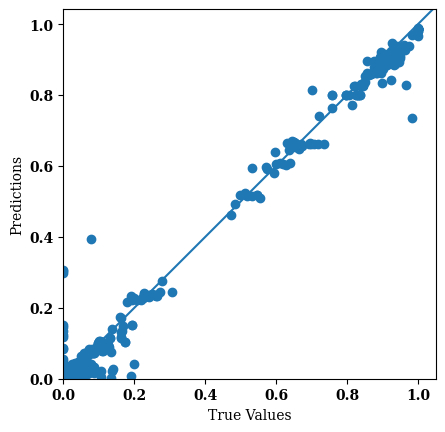

In [57]:
XGBmodel1 = XGBRegressor(n_estimators=100, max_depth=5, eta=0.05)
XGBmodel1 = XGBmodel1.fit(X_train, y_train)
reg_acc(XGBmodel1, X_test, y_test)

# APPLICATION DATASET

In [58]:
%cd "/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/application_datasets"

/home/usr/Documents/diversos/novos datasets/OPEN-RAN-DS/application_datasets


/home/usr/anaconda3/envs/cnn-env/lib/python3.11/site-packages/IPython/core/magics/osm.py:417: UserWarning:

using dhist requires you to install the `pickleshare` library.



In [59]:
df_app = pd.read_csv("application.csv")

In [60]:
df_app.columns

Index(['date_exp', 'gpu_platform', 'BW', 'img_resolution', 'airtime_ratio',
       'gpu_power', 'av_end2end_delay', 'av_imp_proc_delay', 'av_gpu_delay',
       'av_num_obj', 'av_obj_size', 'AP1', 'AP2', 'AP3', 'AP4', 'AP5', 'AP6',
       'AR1', 'AR2', 'AR3', 'AR4', 'AR5', 'AR6', 'powermeter_av',
       'powermeter_var', 'powermeter_median', 'rapl_av', 'rapl_var', 'gpu_av',
       'gpu_var', 'clocksp_av', 'im_ids', 'end2end_delay', 'imp_proc_delay',
       'gpu_delay', 'confidences', 'num_obj', 'obj_size', 'AP_per_image'],
      dtype='object')

In [61]:
df_app.describe()

,date_exp,BW,img_resolution,airtime_ratio,gpu_power,av_end2end_delay,av_imp_proc_delay,av_gpu_delay,av_num_obj,av_obj_size,...,AR5,AR6,powermeter_av,powermeter_var,powermeter_median,rapl_av,rapl_var,gpu_av,gpu_var,clocksp_av
count,1.000000e+03,1000.0,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,700.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,2.011167e+09,100.0,55.000000,0.550000,190.000000,0.666778,0.019824,0.183071,4.774218,76820.822657,...,0.409586,0.572939,174.630148,1459.732788,164.531530,11.641048,0.191553,110.107483,1663.181379,4367.701485
std,9.406775e+03,0.0,28.737185,0.287372,57.474371,0.464839,0.002842,0.097901,1.286936,1939.894428,...,0.228112,0.209211,29.566515,897.472064,26.790542,0.491073,0.721989,27.203048,1137.986755,10.503749
min,2.011161e+09,100.0,10.000000,0.100000,100.000000,0.208601,0.015810,0.118598,1.657718,74511.658780,...,0.004926,0.112315,114.658029,188.140879,116.690000,10.520000,0.000000,55.545349,169.577882,4339.428571
25%,2.011161e+09,100.0,30.000000,0.300000,140.000000,0.339411,0.017055,0.128894,4.260000,75200.213126,...,0.216014,0.468143,149.740593,756.395480,149.597500,11.261489,0.063106,86.949786,756.129274,4359.057288
50%,2.011161e+09,100.0,55.000000,0.550000,190.000000,0.487706,0.019495,0.146397,5.338926,75672.265537,...,0.512502,0.684510,172.190377,1299.021162,164.685000,11.563500,0.096030,108.660623,1398.930709,4369.437799
75%,2.011182e+09,100.0,80.000000,0.800000,240.000000,0.854862,0.022275,0.182550,5.693333,79663.450221,...,0.609888,0.717172,195.888107,2017.055848,174.802500,11.914208,0.141862,129.482018,2370.419091,4375.969228
max,2.011182e+09,100.0,100.000000,1.000000,280.000000,2.429382,0.024872,0.623279,5.852349,80233.978175,...,0.631977,0.737832,265.099220,5858.596681,272.270000,14.891600,12.131931,188.352199,5782.870731,4407.120000
